# 1. Packges

In [652]:
conda install -c conda-forge ydata-profiling


Retrieving notices: done
Channels:
 - conda-forge
 - defaults
Platform: osx-64
Solving environment: done

# All requested packages already installed.


Note: you may need to restart the kernel to use updated packages.


In [653]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from ydata_profiling import ProfileReport

# 2. Import, load and filter the data

In [654]:
# and ran imported and run input files for each year in R

In [655]:
#data = pd.read_csv('NISPUF23.csv') 
data23 = pd.read_csv("NISPUF23.csv", low_memory=False)
data23.head()
data23.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38619 entries, 0 to 38618
Columns: 493 entries, SEQNUMC to INS_BREAK_I
dtypes: float64(350), int64(4), object(139)
memory usage: 145.3+ MB


By two years of age, it is recommended that all children should have received 4 doses of diphtheria-tetanus-pertussis (DTaP), 3 doses of polio, 1 dose of measles-mumps-rubella (MMR), 3 doses of Haemophilis Influenza, type B (Hib), 3 doses of Hepatitis B, 1 dose of Varicella, and 4 doses of Pneumococcal vaccine. This series is referred to in shorthand as "4:3:1:3:3:1:4."

In [656]:
cols_UTD = [col for col in data23.columns if col.upper().startswith(('P_UTD', 'PUT','PU4'))]
print(cols_UTD)

['P_UTD331', 'P_UTD431', 'P_UTDCOV1', 'P_UTDCOV_BOOST', 'P_UTDCOV_FULL', 'P_UTDHEP', 'P_UTDHEPA1', 'P_UTDHEPA2', 'P_UTDHIB', 'P_UTDHIB_ROUT_S', 'P_UTDHIB_SHORT_S', 'P_UTDMCV', 'P_UTDMMX', 'P_UTDPC3', 'P_UTDPCV', 'P_UTDPCVB13', 'P_UTDPOL', 'P_UTDROT_S', 'P_UTDTP3', 'P_UTDTP4', 'PU431331', 'P_UTD431H31_ROUT_S', 'PU4313313', 'P_UTD431H313_ROUT_S', 'PU4313314', 'P_UTD431H314_ROUT_S', 'PUT43133', 'P_UTD431H3_ROUT_S', 'PUTD4313', 'P_UTD431H_ROUT_S']


In [657]:
# select columns of interest for each year
selected_columns23 = ['AGEGRP', 'SEX', 'C1R', 'CHILDNM', 'EDUC1', 'M_AGEGRP2', 'INCQ298A', 'INCPOV1', 'RACEETHK', 'STATE', 'YEAR', 'ESTIAP23'\
                    , 'EST_GRANT', 'SEQNUMC', 'SEQNUMHH', 'MMR1_AGE', 'MMR2_AGE', 'MMR3_AGE', 'DMMR1', 'DMMR2', 'DMMR3', 'DTP1_AGE', 'DTP2_AGE', 'DTP3_AGE', \
                    'INS_BREAK_I', 'INS_STAT2_I', 'CWIC_01', 'CWIC_02','PROV_FAC', 'RDDWT_C', 'PROVWT_C', 'PDAT', 'STRATUM', 'P_NUMMMR', 'P_NUMMCN', 'P_NUMDTP',\
                     ] + cols_UTD

In [658]:
selected_columns22 = ['AGEGRP', 'SEX', 'C1R', 'CHILDNM', 'EDUC1', 'M_AGEGRP2', 'INCQ298A', 'INCPOV1', 'RACEETHK', 'STATE', 'YEAR', 'ESTIAP22'\
                    , 'EST_GRANT', 'SEQNUMC', 'SEQNUMHH', 'MMR1_AGE', 'MMR2_AGE', 'MMR3_AGE', 'DMMR1', 'DMMR2', 'DMMR3', 'DTP1_AGE', 'DTP2_AGE', 'DTP3_AGE', \
                    'INS_BREAK_I', 'INS_STAT2_I', 'CWIC_01', 'CWIC_02','PROV_FAC', 'RDDWT_C', 'PROVWT_C', 'PDAT', 'STRATUM', 'P_NUMMMR', 'P_NUMMCN', \
                      'P_NUMDTP'] + cols_UTD
vars_to_drop22 = ['P_UTDCOV1', 'P_UTDCOV_BOOST', 'P_UTDCOV_FULL']
selected_columns22 = [col for col in selected_columns22 if col not in vars_to_drop22]

In [659]:
selected_columns21 = ['AGEGRP', 'SEX', 'C1R', 'CHILDNM', 'EDUC1', 'M_AGEGRP2', 'INCQ298A', 'INCPOV1', 'RACEETHK', 'STATE', 'YEAR', 'ESTIAP21'\
                    , 'EST_GRANT', 'SEQNUMC', 'SEQNUMHH', 'MMR1_AGE', 'MMR2_AGE', 'MMR3_AGE', 'DMMR1', 'DMMR2', 'DMMR3', 'DTP1_AGE', 'DTP2_AGE', 'DTP3_AGE', \
                    'INS_BREAK_I', 'INS_STAT2_I', 'CWIC_01', 'CWIC_02','PROV_FAC', 'RDDWT_C', 'PROVWT_C', 'PDAT', 'STRATUM', 'P_NUMMMR', 'P_NUMMCN', \
                      'P_NUMDTP']+ cols_UTD
vars_to_drop21 = ['P_UTDCOV1', 'P_UTDCOV_BOOST', 'P_UTDCOV_FULL']
selected_columns21 = [col for col in selected_columns21 if col not in vars_to_drop21]

In [660]:
selected_columns20 = ['AGEGRP', 'SEX', 'C1R', 'CHILDNM', 'EDUC1', 'M_AGEGRP2', 'INCQ298A', 'INCPOV1', 'RACEETHK', 'STATE', 'YEAR', 'ESTIAP20'\
                    , 'EST_GRANT', 'SEQNUMC', 'SEQNUMHH', 'MMR1_AGE', 'MMR2_AGE', 'MMR3_AGE', 'DMMR1', 'DMMR2', 'DMMR3', 'DTP1_AGE', 'DTP2_AGE', 'DTP3_AGE', \
                    'INS_BREAK_I', 'INS_STAT2_I', 'CWIC_01', 'CWIC_02','PROV_FAC', 'RDDWT_C', 'PROVWT_C', 'PDAT', 'STRATUM', 'P_NUMMMR', 'P_NUMMCN',\
                      'P_NUMDTP'] + cols_UTD
vars_to_drop20 = ['P_UTDCOV1', 'P_UTDCOV_BOOST', 'P_UTDCOV_FULL']
selected_columns20 = [col for col in selected_columns20 if col not in vars_to_drop20]

In [661]:
# Keep only those columns
data23 = data23[selected_columns23]


In [662]:
data22 = pd.read_csv("NISPUF22.csv", low_memory=False)
data22 = data22[selected_columns22]

In [663]:
data21 = pd.read_csv("NISPUF21.csv", low_memory=False)
print(data21.shape)
cols_EST = [col for col in data21.columns if col.upper().startswith('EST')]
print(cols_EST)
print(data21.index)
data21 = data21[selected_columns21]

(35995, 457)
['ESTIAP21', 'EST_GRANT']
RangeIndex(start=0, stop=35995, step=1)


In [664]:
data20 = pd.read_csv("NISPUF20.csv", low_memory=False)
data20 = data20[selected_columns20]
data20['YEAR'] = 2020
data20['YEAR'].unique

<bound method Series.unique of 0        2020
1        2020
2        2020
3        2020
4        2020
         ... 
35990    2020
35991    2020
35992    2020
35993    2020
35994    2020
Name: YEAR, Length: 35995, dtype: int64>

# 3. Append the data frames for all years

In [665]:
# append all data frames
data = pd.concat([data20, data21, data22, data23], ignore_index=True)
data.shape

(146312, 69)

In [666]:
data["YEAR"].unique()

array([2020, 2021, 2022, 2023])

# 4. Upload county level TX ImmTrac2 Data
If I can find county-level data to enrich this data, that would be preferrable to using the state-level NIS Child survey data

In [667]:
# county-level Texas data
filename = 'ImmTrac2-Doses-Administered-for-web.xlsx'
excel_file = pd.ExcelFile(filename)
TXdata = excel_file.parse(1) # Indexing starts at 0, so 1 refers to the second sheet
type(TXdata)
TXdata.head()

,"Vaccinations Administered Year-to-Date, 2020-2024, Texas Immunization Registry, ImmTrac2",Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5
0,County,Year,Month,Age at Vaccination,Vaccine of Interest,Number of Vaccinations
1,Anderson,2020,January,0 to 24 months,Pediatric MMR,30
2,Anderson,2020,January,0 to 24 months,All Other,657
3,Anderson,2020,January,2-8 years,Pediatric MMR,28
4,Anderson,2020,January,2-8 years,All Other,68


# 5. Profile NIS Child data

Refer to 
* YData Profile [documentation](https://docs.profiling.ydata.ai/latest/)
* this GitHub readme [document]('https://github.com/ydataai/ydata-profiling/blob/develop/README.md')

In [723]:
# try out the Ydata profile
profile = ProfileReport(data23, title="Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|███████████████████████████████████████████| 66/66 [00:03<00:00, 18.00it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 6. Further Explore Data!

## 6.1 Explore the categorical variables

In [669]:
# list of categorical variables
data.select_dtypes(include='object').columns
# create a list
categorical_cols = data.select_dtypes(include='object').columns.tolist()  # For string-based categorical data

In [670]:
# remove time variables DMMR1, DMMR2
categorical_cols = [col for col in categorical_cols if col not in ['DMMR1', 'DMMR2']]

In [671]:
# change the data type from object or number to category 
categorical_cols = [col for col in categorical_cols if not col.startswith("ESTIAP")]
# categorical_cols = [col for col in categorical_cols if col not in cols_UTD]
# add back P_UTDPCVB13 since that is a categorical variable unlike other variables in the cols_UTD list which binary \
# and easier to aggregate when they are saved as a numeric data value type 
# categorical_cols += ["P_UTDPCVB13"]
print(categorical_cols)

['AGEGRP', 'SEX', 'C1R', 'CHILDNM', 'EDUC1', 'M_AGEGRP2', 'INCQ298A', 'INCPOV1', 'RACEETHK', 'STATE', 'EST_GRANT', 'INS_BREAK_I', 'INS_STAT2_I', 'CWIC_01', 'CWIC_02', 'PROV_FAC', 'PDAT', 'P_UTD331', 'P_UTD431', 'P_UTDHEP', 'P_UTDHEPA1', 'P_UTDHEPA2', 'P_UTDHIB', 'P_UTDHIB_ROUT_S', 'P_UTDHIB_SHORT_S', 'P_UTDMCV', 'P_UTDMMX', 'P_UTDPC3', 'P_UTDPCV', 'P_UTDPCVB13', 'P_UTDPOL', 'P_UTDROT_S', 'P_UTDTP3', 'P_UTDTP4', 'PU431331', 'P_UTD431H31_ROUT_S', 'PU4313313', 'P_UTD431H313_ROUT_S', 'PU4313314', 'P_UTD431H314_ROUT_S', 'PUT43133', 'P_UTD431H3_ROUT_S', 'PUTD4313', 'P_UTD431H_ROUT_S', 'P_UTDCOV1', 'P_UTDCOV_BOOST', 'P_UTDCOV_FULL']


In [672]:
cat_list = [data[col].value_counts() for col in categorical_cols]
cat_list

[AGEGRP
 30 - 35 MONTHS    59932
 24 - 29 MONTHS    43677
 19 - 23 MONTHS    42703
 Name: count, dtype: int64,
 SEX
 MALE      74873
 FEMALE    71439
 Name: count, dtype: int64,
 C1R
 4     52619
 3     35777
 5     29007
 6     13674
 7      5845
 8+     5327
 2      4063
 Name: count, dtype: int64,
 CHILDNM
 TWO OR THREE    85954
 ONE             42506
 FOUR OR MORE    17852
 Name: count, dtype: int64,
 EDUC1
 COLLEGE GRAD                    77470
 > 12 YEARS, NON-COLLEGE GRAD    35966
 12 YEARS                        24723
 < 12 YEARS                       8153
 Name: count, dtype: int64,
 M_AGEGRP2
 >= 30 YEARS    106689
 <= 29 YEARS     39623
 Name: count, dtype: int64,
 INCQ298A
 $75001+            72032
 $60001 - $75000    10991
 $40001 - $50000     8629
 $50001 - $60000     8075
 DON'T KNOW          5926
 $35001 - $40000     5806
 REFUSED             5639
 $25001 - $30000     5234
 $10001 - $17500     4441
 $17501 - $20000     4355
 $0 - $7500          4126
 $20001 - $25000    

In [673]:
for col in categorical_cols:
    before = (data[col].dtype)
    data[col] = data[col].astype('category')
    after = data[col].dtype
    print(before, after)

object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category
object category


In [674]:
lists = [data[col].value_counts() for col in cols_UTD]
lists

[P_UTD331
 UTD        66543
 NOT UTD     6082
 Name: count, dtype: int64,
 P_UTD431
 UTD        62882
 NOT UTD     9743
 Name: count, dtype: int64,
 P_UTDCOV1
 NOT UTD    13282
 UTD         5130
 Name: count, dtype: int64,
 P_UTDCOV_BOOST
 NOT UTD    15848
 UTD         2564
 Name: count, dtype: int64,
 P_UTDCOV_FULL
 NOT UTD    14601
 UTD         3811
 Name: count, dtype: int64,
 P_UTDHEP
 UTD        65929
 NOT UTD     6696
 Name: count, dtype: int64,
 P_UTDHEPA1
 UTD        65995
 NOT UTD     6630
 Name: count, dtype: int64,
 P_UTDHEPA2
 UTD        53132
 NOT UTD    19493
 Name: count, dtype: int64,
 P_UTDHIB
 UTD        62568
 NOT UTD    10057
 Name: count, dtype: int64,
 P_UTDHIB_ROUT_S
 UTD        61574
 NOT UTD    11051
 Name: count, dtype: int64,
 P_UTDHIB_SHORT_S
 UTD        65948
 NOT UTD     6677
 Name: count, dtype: int64,
 P_UTDMCV
 UTD        67866
 NOT UTD     4759
 Name: count, dtype: int64,
 P_UTDMMX
 UTD        67364
 NOT UTD     5261
 Name: count, dtype: int64,
 P_UTDP

In [675]:
# Convert year from integer to category
data["YEAR"].dtype
data["YEAR"] = data["YEAR"].astype('category')
assert data["YEAR"].dtype == 'category'

In [676]:
# Check out how  much data is bsed on adequate provider data
pd.crosstab(data['PDAT'], data['YEAR'], normalize='index')

YEAR,2020,2021,2022,2023
PDAT,,,,
CHILD DOES NOT HAVE ADEQUATE PROVIDER DATA,0.239879,0.239879,0.246014,0.274227
CHILD HAS ADEQUATE PROVIDER DATA OR ZERO VACCINATIONS,0.252241,0.252241,0.241997,0.253522


### 6.1.1 Examine relationships between categorical variables

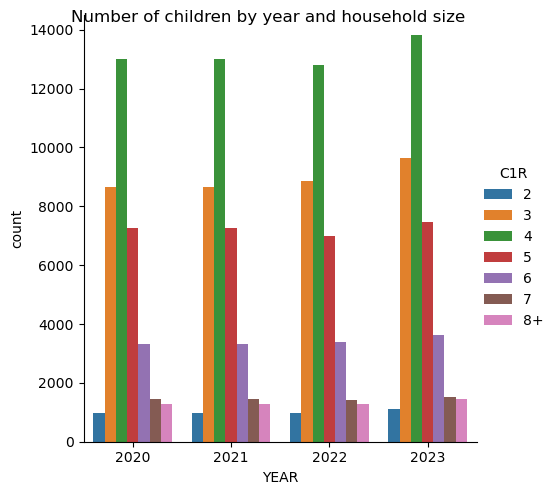

In [677]:
year_x_hhsize = sns.catplot(data = data, x ="YEAR", hue = "C1R", kind = "count")
year_x_hhsize.fig.suptitle('Number of children by year and household size')
plt.show()

Text(0.5, 0.98, 'Number of children by year and age group')

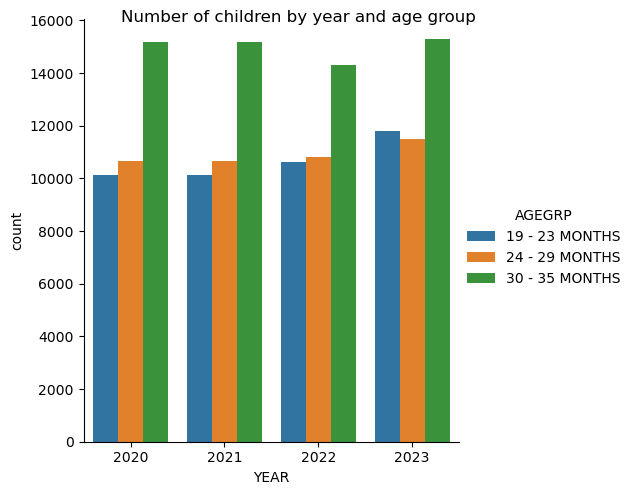

In [678]:
year_x_agegrp = sns.catplot(data=data, x="YEAR", kind="count", hue = "AGEGRP")
year_x_agegrp.fig.suptitle('Number of children by year and age group')


Text(0.5, 0.98, 'Level of maternal educ by year')

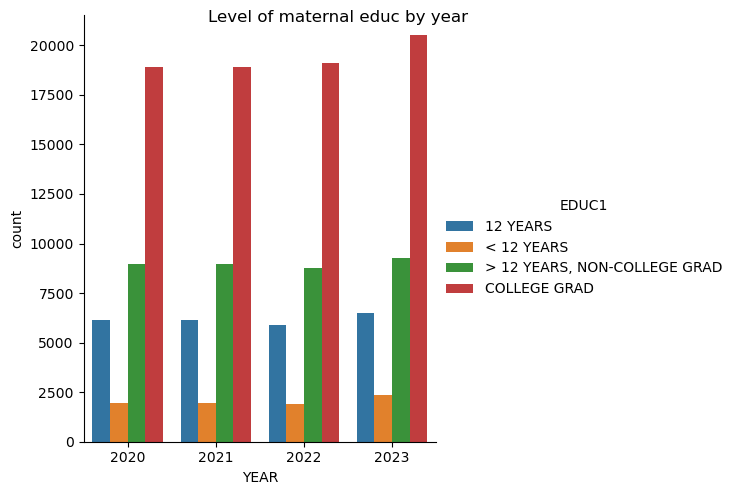

In [679]:
year_x_motherseduc1 = sns.catplot(data=data, x="YEAR", kind="count", hue = "EDUC1")
year_x_motherseduc1.fig.suptitle('Level of maternal educ by year')


### 6.1.2 Order values for categorical variables

In [680]:
# Order values for certain categorical variables so they display well in visualizations
data['INCQ298A'].value_counts(sort=False)
# categories are not in order, to fix

INCQ298A
$0 - $7500          4126
$10001 - $17500     4441
$17501 - $20000     4355
$20001 - $25000     4086
$25001 - $30000     5234
$30001 - $35000     3767
$35001 - $40000     5806
$40001 - $50000     8629
$50001 - $60000     8075
$60001 - $75000    10991
$75001+            72032
$7501 - $10000      3205
DON'T KNOW          5926
REFUSED             5639
Name: count, dtype: int64

In [681]:
data['INCQ298A'].unique()

['$75001+', '$17501 - $20000', 'REFUSED', 'DON'T KNOW', '$40001 - $50000', ..., '$35001 - $40000', '$20001 - $25000', '$7501 - $10000', '$30001 - $35000', '$0 - $7500']
Length: 14
Categories (14, object): ['$0 - $7500', '$10001 - $17500', '$17501 - $20000', '$20001 - $25000', ..., '$75001+', '$7501 - $10000', 'DON'T KNOW', 'REFUSED']

In [682]:
# Define the desired order
INCQ298A_order = ["$0 - $7500", "$7501 - $10000","$10001 - $17500", "$17501 - $20000", "$20001 - $25000", "$25001 - $30000", \
                  "$30001 - $35000","$35001 - $40000","$40001 - $45000","$50001 - $50000","$60001 - $65000","$65001 - $70000", \
                  "$70001 - $75000","$75001+","DON'T KNOW", "REFUSED"]

In [683]:
# Convert column to ordered categorical type
data["INCQ298A"] = pd.Categorical(data["INCQ298A"], categories=INCQ298A_order, ordered=True)

In [684]:
data['INCQ298A'].value_counts(sort=False)

INCQ298A
$0 - $7500          4126
$7501 - $10000      3205
$10001 - $17500     4441
$17501 - $20000     4355
$20001 - $25000     4086
$25001 - $30000     5234
$30001 - $35000     3767
$35001 - $40000     5806
$40001 - $45000        0
$50001 - $50000        0
$60001 - $65000        0
$65001 - $70000        0
$70001 - $75000        0
$75001+            72032
DON'T KNOW          5926
REFUSED             5639
Name: count, dtype: int64

In [685]:
pd.crosstab(data['INCQ298A'], data['INCPOV1'], normalize='index')

INCPOV1,"ABOVE POVERTY, <= $75K","ABOVE POVERTY, > $75K",BELOW POVERTY,UNKNOWN
INCQ298A,,,,
$0 - $7500,0.000000,0.0,1.000000,0.000000
$7501 - $10000,0.000000,0.0,1.000000,0.000000
$10001 - $17500,0.000000,0.0,1.000000,0.000000
$17501 - $20000,0.043858,0.0,0.956142,0.000000
$20001 - $25000,0.273862,0.0,0.726138,0.000000
$25001 - $30000,0.538403,0.0,0.461597,0.000000
$30001 - $35000,0.770905,0.0,0.229095,0.000000
$35001 - $40000,0.887013,0.0,0.112987,0.000000
$75001+,0.000000,1.0,0.000000,0.000000


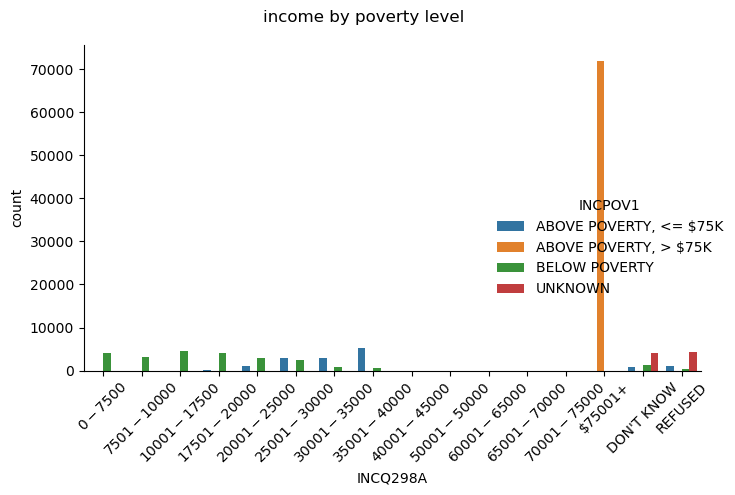

In [686]:
income_x_povertylevel = sns.catplot(data=data, x="INCQ298A", kind="count", hue = "INCPOV1")
income_x_povertylevel.fig.suptitle('income by poverty level')
for ax in income_x_povertylevel.axes.flat:
    for label in ax.get_xticklabels():
        label.set_rotation(45)  # or 60 or 90 depending on your needs

plt.tight_layout()
plt.show()

<Axes: xlabel='INCQ298A', ylabel='INCPOV1'>

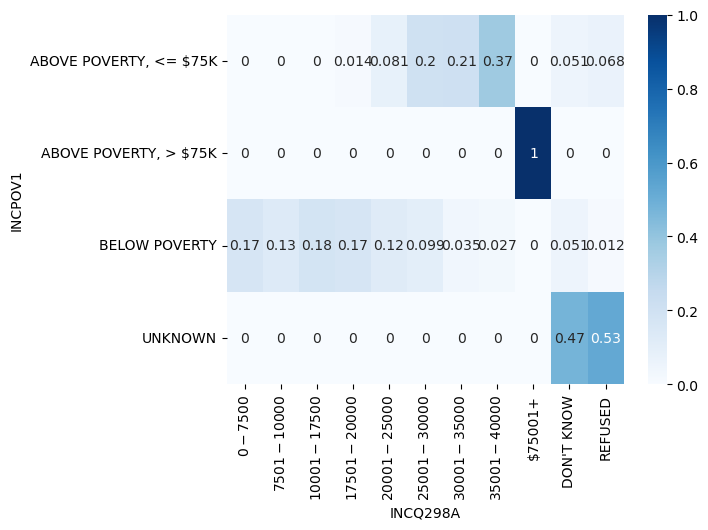

In [687]:
ct = pd.crosstab(data['INCPOV1'], data['INCQ298A'], normalize='index')
sns.heatmap(ct, annot=True, cmap="Blues")

In [688]:
print(pd.crosstab(data['INS_BREAK_I'], data['YEAR']))

YEAR                                                 2021   2022   2023
INS_BREAK_I                                                            
CURRENTLY INSURED AND NEVER UNINSURED SINCE BIRTH   17088  16585  17153
CURRENTLY INSURED BUT UNINSURED AT SOME POINT S...    902    710    818
CURRENTLY UNINSURED AND NEVER INSURED SINCE BIRTH     101    102    144
CURRENTLY UNINSURED BUT INSURED AT SOME POINT S...    207    167    275
MISSING                                             17697      0      0


### 6.1.3 Examine composite vaccination variables

Understanding the 4:3:1:3:3:1:4 Vaccination Series
The notation 4:3:1:3:3:1:4 represents the recommended number of doses for seven key vaccines in early childhood:

4 doses of DTaP: Diphtheria, Tetanus, and acellular Pertussis vaccine.

3 doses of Polio: Poliovirus vaccine.

1 dose of MMR: Measles, Mumps, and Rubella vaccine.

3 doses of Hib: Haemophilus influenzae type b vaccine.

3 doses of HepB: Hepatitis B vaccine.

1 dose of Varicella: Chickenpox vaccine, administered at age 12 months or older.

4 doses of PCV: Pneumococcal Conjugate Vaccine

In [689]:
# compare a composite variable for up to date vaccination status with the # of MMR shots rcvd by 36 months
pd.crosstab(data.PU4313314, data.P_NUMMMR)

P_NUMMMR,0.0,1.0,2.0,3.0,5.0
PU4313314,,,,,
NOT UTD,7949,7488,245,13,0
UTD,13975,41563,1354,37,1


In [690]:
# UTD (UP-TO-DATE) FLAG FOR PROVIDER 4:3:1:3:3 BY 36 MONTHS OF AGE,
# EXCLUDING ANY VACCINATIONS AFTER THE HOUSEHOLD INTERVIEW DATE.
# this composite variable excludes varicella and PCV doses, so less stringent standard for complete
# vaccination
pd.crosstab(data.PUT43133, data.P_NUMMMR)

P_NUMMMR,0.0,1.0,2.0,3.0,5.0
PUT43133,,,,,
NOT UTD,8310,5477,146,8,0
UTD,13614,43574,1453,42,1


In [691]:
data.PUT43133.value_counts()

PUT43133
UTD        58684
NOT UTD    13941
Name: count, dtype: int64

### 6.1.4 Create aggregate state-level variables from categorical variables

In [692]:
# double check data types of categorical variables 
catypes = [data[col].dtypes for col in categorical_cols]
print(catypes)

[CategoricalDtype(categories=['19 - 23 MONTHS', '24 - 29 MONTHS', '30 - 35 MONTHS'], ordered=False, categories_dtype=object), CategoricalDtype(categories=['FEMALE', 'MALE'], ordered=False, categories_dtype=object), CategoricalDtype(categories=['2', '3', '4', '5', '6', '7', '8+'], ordered=False, categories_dtype=object), CategoricalDtype(categories=['FOUR OR MORE', 'ONE', 'TWO OR THREE'], ordered=False, categories_dtype=object), CategoricalDtype(categories=['12 YEARS', '< 12 YEARS', '> 12 YEARS, NON-COLLEGE GRAD',
                  'COLLEGE GRAD'],
, ordered=False, categories_dtype=object), CategoricalDtype(categories=['<= 29 YEARS', '>= 30 YEARS'], ordered=False, categories_dtype=object), CategoricalDtype(categories=['$0 - $7500', '$7501 - $10000', '$10001 - $17500',
                  '$17501 - $20000', '$20001 - $25000', '$25001 - $30000',
                  '$30001 - $35000', '$35001 - $40000', '$40001 - $45000',
                  '$50001 - $50000', '$60001 - $65000', '$65001 - $70000

In [693]:
# Narrow down the list of categorical columns to summarize since the types are causing issues in aggregation
# the variables containing the intger sequence 4313 are outcome composite variables that indicate whether
# a child is up to date for different combinations of shots
cats_to_sum_df = data[[col for col in data.columns if '4313' in col]]
cat_cols_to_sum = cats_to_sum_df.columns
dtypes = data[cat_cols_to_sum].dtypes
print(dtypes)

PU431331     category
PU4313313    category
PU4313314    category
PUT43133     category
PUTD4313     category
dtype: object


In [694]:
# PUT43133 - aggregate categorical variables across states. Do this for a single categorical variable PUT43133 for starters

# Count the values of PUT43133 by year and state, including the number of missing values. 
# The unstack(fill_value=0) part reshapes the result so that instead of the counts for each response option being in a different row
# each unique value of PUT43133 becomes a separate column containing the counts for each the year/state row 
# Any missing combinations are filled with zeros.
PUT43133_counts_df = data.groupby(['YEAR','STATE'], observed = True)['PUT43133'].value_counts(dropna=False).unstack(fill_value=0)
print(type(PUT43133_counts_df))
PUT43133_counts_df

<class 'pandas.core.frame.DataFrame'>


PUT43133            NaN  NOT UTD  UTD
YEAR STATE                           
2020 ALABAMA        256       67  187
     ALASKA         230      104  181
     ARIZONA        212       74  160
     ARKANSAS       367      105  308
     CALIFORNIA     635      143  410
...                 ...      ...  ...
2023 VIRGINIA       596       96  387
     WASHINGTON     367       77  385
     WEST VIRGINIA  325       49  212
     WISCONSIN      358       57  261
     WYOMING        241       65  259

[208 rows x 3 columns]

In [695]:
# Computes the sum of each row across all columns to get the proportion who fall into each category. 
# The axis=1 parameter specifies that the sum should be calculated horizontally across columns for each row. 
# The .div() function performs element-wise division. Each element for the variable is divided 
# by the corresponding row sum. The axis=0 parameter indicates that the division should align on the index (rows).
PUT43133_proportions_df = PUT43133_counts.div(PUT43133_counts.sum(axis=1), axis=0)
PUT43133_proportions_df

PUT43133                 NaN   NOT UTD       UTD
YEAR STATE                                      
2020 ALABAMA        0.501961  0.131373  0.366667
     ALASKA         0.446602  0.201942  0.351456
     ARIZONA        0.475336  0.165919  0.358744
     ARKANSAS       0.470513  0.134615  0.394872
     CALIFORNIA     0.534512  0.120370  0.345118
...                      ...       ...       ...
2023 VIRGINIA       0.552363  0.088971  0.358665
     WASHINGTON     0.442702  0.092883  0.464415
     WEST VIRGINIA  0.554608  0.083618  0.361775
     WISCONSIN      0.529586  0.084320  0.386095
     WYOMING        0.426549  0.115044  0.458407

[208 rows x 3 columns]

In [696]:
# combine the counts and proportions into a single data frame for PUT43133
# add suffixes (_count) and (_prop) to the column names to distinguish what they represent
PUT43133_counts_props_df = pd.concat([PUT43133_counts.add_suffix('_count'), PUT43133_proportions.add_suffix('_prop')], axis=1)
print(PUT43133_counts_props_df.head())
print(PUT43133_counts_props_df.index)

PUT43133         nan_count  NOT UTD_count  UTD_count  nan_prop  NOT UTD_prop  \
YEAR STATE                                                                     
2020 ALABAMA           256             67        187  0.501961      0.131373   
     ALASKA            230            104        181  0.446602      0.201942   
     ARIZONA           212             74        160  0.475336      0.165919   
     ARKANSAS          367            105        308  0.470513      0.134615   
     CALIFORNIA        635            143        410  0.534512      0.120370   

PUT43133         UTD_prop  
YEAR STATE                 
2020 ALABAMA     0.366667  
     ALASKA      0.351456  
     ARIZONA     0.358744  
     ARKANSAS    0.394872  
     CALIFORNIA  0.345118  
MultiIndex([(2020,              'ALABAMA'),
            (2020,               'ALASKA'),
            (2020,              'ARIZONA'),
            (2020,             'ARKANSAS'),
            (2020,           'CALIFORNIA'),
            (2020,     

In [697]:
# Retain just the proportion in each category that was up to date (UTD) for the shot combination represented by the 43133 variable
PUT43133_proportions_df = pd.DataFrame(PUT43133_proportions_df["UTD"])
print(type(PUT43133_proportions_df))
# rename the column so it can be later combined with proportions for other composite UTD variables
PUT43133_proportions_df = PUT43133_proportions_df.rename(columns={PUT43133_proportions_df.columns[0]: 'PUT43133_UTD_prop'})
PUT43133_proportions_df.head()

<class 'pandas.core.frame.DataFrame'>


PUT43133_UTD_prop
YEAR STATE                        
2020 ALABAMA              0.366667
     ALASKA               0.351456
     ARIZONA              0.358744
     ARKANSAS             0.394872
     CALIFORNIA           0.345118

In [698]:
# Try making a summary data frame with proportions of UTD kids by state/year again, but for PU4313313

PU4313313_counts = data.groupby(['YEAR','STATE'], observed = True)['PU4313313'].value_counts(dropna=False).unstack(fill_value=0)
# This computes the sum of each row across all columns. The axis=1 parameter specifies that the sum should be calculated horizontally 
# across columns for each row. The .div() function performs element-wise division. Here, each element in PU4313313_counts is divided 
# by the corresponding row sum calculated earlier in the same line of code. The axis=0 parameter indicates that the division 
# should align on the index (rows).
PU4313313_proportions_df = PU4313313_counts.div(PU4313313_counts.sum(axis=1), axis=0)
PU4313313_proportions_df.head()
PU4313313_proportions_df = pd.DataFrame(PU4313313_proportions_df["UTD"])
PU4313313_proportions_df
# rename the column
PU4313313_proportions_df = PU4313313_proportions_df.rename(columns={PU4313313_proportions_df.columns[0]: 'PU4313313_UTD_prop'})
PU4313313_prop_df.head()

PU4313313_UTD_prop
YEAR STATE                         
2020 ALABAMA               0.384314
     ALASKA                0.380583
     ARIZONA               0.369955
     ARKANSAS              0.410256
     CALIFORNIA            0.353535

In [699]:
# Repeat for PU4313314
PU4313314_counts = data.groupby(['YEAR','STATE'], observed = True)['PU4313314'].value_counts(dropna=False).unstack(fill_value=0)
PU4313314_proportions = PU4313314_counts.div(PU4313314_counts.sum(axis=1), axis=0)
result = pd.concat([PU4313314_counts.add_suffix('_count'), PU4313314_proportions.add_suffix('_prop')], axis=1)
PU4313314_prop_df = pd.DataFrame(result["UTD_prop"])
PU4313314_prop_df = PU4313314_prop_df.rename(columns={PU4313314_prop_df.columns[0]: 'PU4313314_UTD_prop'})
PU4313314_prop_df.head()

PU4313314_UTD_prop
YEAR STATE                         
2020 ALABAMA               0.382353
     ALASKA                0.378641
     ARIZONA               0.369955
     ARKANSAS              0.410256
     CALIFORNIA            0.352694

In [700]:
# Repeat for PUT43133
PUT43133_counts = data.groupby(['YEAR','STATE'], observed = True)['PUT43133'].value_counts(dropna=False).unstack(fill_value=0)
PUT43133_proportions = PUT43133_counts.div(PUT43133_counts.sum(axis=1), axis=0)
result = pd.concat([PUT43133_counts.add_suffix('_count'), PUT43133_proportions.add_suffix('_prop')], axis=1)
PUT43133_prop_df = pd.DataFrame(result["UTD_prop"])
PUT43133_prop_df = PUT43133_prop_df.rename(columns={PUT43133_prop_df.columns[0]: 'PUT43133_UTD_prop'})
PUT43133_prop_df.head()

PUT43133_UTD_prop
YEAR STATE                        
2020 ALABAMA              0.366667
     ALASKA               0.351456
     ARIZONA              0.358744
     ARKANSAS             0.394872
     CALIFORNIA           0.345118

In [701]:
# Repeat for PUTD4313
PUTD4313_counts = data.groupby(['YEAR','STATE'], observed = True)['PUTD4313'].value_counts(dropna=False).unstack(fill_value=0)
PUTD4313_proportions = PUTD4313_counts.div(PUTD4313_counts.sum(axis=1), axis=0)
result = pd.concat([PUTD4313_counts.add_suffix('_count'), PUTD4313_proportions.add_suffix('_prop')], axis=1)
PUTD4313_prop_df = pd.DataFrame(result["UTD_prop"])
PUTD4313_prop_df = PUTD4313_prop_df.rename(columns={PUTD4313_prop_df.columns[0]: 'PUTD4313_UTD_prop'})
PUTD4313_prop_df.head()

PUTD4313_UTD_prop
YEAR STATE                        
2020 ALABAMA              0.388235
     ALASKA               0.386408
     ARIZONA              0.372197
     ARKANSAS             0.411538
     CALIFORNIA           0.358586

In [702]:
list_of_dfs = [PUT43133_prop_df, PU4313314_prop_df, PUT43133_prop_df, PUTD4313_prop_df]
outcome_summary_df = pd.concat(list_of_dfs, axis=1)
outcome_summary_df

PUT43133_UTD_prop  PU4313314_UTD_prop  PUT43133_UTD_prop  \
YEAR STATE                                                                     
2020 ALABAMA                 0.366667            0.382353           0.366667   
     ALASKA                  0.351456            0.378641           0.351456   
     ARIZONA                 0.358744            0.369955           0.358744   
     ARKANSAS                0.394872            0.410256           0.394872   
     CALIFORNIA              0.345118            0.352694           0.345118   
...                               ...                 ...                ...   
2023 VIRGINIA                0.358665            0.347544           0.358665   
     WASHINGTON              0.464415            0.451146           0.464415   
     WEST VIRGINIA           0.361775            0.336177           0.361775   
     WISCONSIN               0.386095            0.375740           0.386095   
     WYOMING                 0.458407            0.433628           0.458407   

                    PUTD4313_UTD_prop  
YEAR STATE                             
2020 ALABAMA                 0.388235  
     ALASKA                  0.386408  
     ARIZONA                 0.372197  
     ARKANSAS                0.411538  
     CALIFORNIA              0.358586  
...                               ...  
2023 VIRGINIA                0.366080  
     WASHINGTON              0.474065  
     WEST VIRGINIA           0.368601  
     WISCONSIN               0.389053  
     WYOMING                 0.463717  

[208 rows x 4 columns]

In [734]:
print(data["EDUC1"].value_counts(dropna = False))
data["EDUC1"].describe()

EDUC1
COLLEGE GRAD                    77470
> 12 YEARS, NON-COLLEGE GRAD    35966
12 YEARS                        24723
< 12 YEARS                       8153
Name: count, dtype: int64


count           146312
unique               4
top       COLLEGE GRAD
freq             77470
Name: EDUC1, dtype: object

In [733]:
print(data["EDUC1"].isnull().sum())
print(data["EDUC1"].unique())

0
['COLLEGE GRAD', '> 12 YEARS, NON-COLLEGE GRAD', '< 12 YEARS', '12 YEARS']
Categories (4, object): ['12 YEARS', '< 12 YEARS', '> 12 YEARS, NON-COLLEGE GRAD', 'COLLEGE GRAD']


### 6.1.5 Create binary versions or dummy variables of categorical variables in the data frame


In [705]:
# Create mappings and replace for EDUC1
educ_mappings = {'12 YEARS':'No', 
            '< 12 YEARS':'No',
            '> 12 YEARS':'No',
            'NON-COLLEGE GRAD': 'No',
           'COLLEGE GRAD': 'Yes',
            'nan':'No'}
#data["college_grad"] = data["EDUC1"].cat.rename_categories(educ_mappings)
data["college_grad"] = data["EDUC1"].map(educ_mappings)
data["college_grad"] = data["college_grad"].astype('category')
data["college_grad"].unique()

['Yes', NaN, 'No']
Categories (2, object): ['No', 'Yes']

In [706]:
if 'college_grad' in data.columns:
    print("Column 'college_grad' does exist in this dataframe")

Column 'college_grad' does exist in this dataframe


In [707]:
data["college_grad"].value_counts(dropna=False)

college_grad
Yes    77470
NaN    35966
No     32876
Name: count, dtype: int64

In [709]:
# Fill missing values with a specific category like 'Missing'
# Cannot convert values to missing since a categorical value can only have a limited set of predefined values
# cannot use the .fillna() method on a categorical variable
correlates_summary_df = pd.DataFrame(data.loc[:,"college_grad"])
print(correlates_summary_df.index)
print(correlates_summary_df.columns)

# replace the text 'nan' with NaN which Pandas recognizes as missing
correlates_summary_df['college_grad'] = correlates_summary_df['college_grad'].replace('nan', np.nan)
correlates_summary_df['college_grad'].value_counts()
missing_mask = correlates_summary_df['college_grad'].isnull()
print(missing_mask)

# not sure I should recode missing values to "No" could help later in modeling but it would also 
# mess up denominators for kids that there is no data for. Leave the missing values as missing for now
# correlates_summary_df['college_grad'] = (correlates_summary_df['college_grad'].fillna('missing')) # TypeError: Cannot setitem on a Categorical with a new category (missing), set the categories first

correlates_summary_df['college_grad'].value_counts()

RangeIndex(start=0, stop=146312, step=1)
Index(['college_grad'], dtype='object')
0         False
1          True
2          True
3         False
4         False
          ...  
146307    False
146308    False
146309    False
146310    False
146311    False
Name: college_grad, Length: 146312, dtype: bool


college_grad
Yes    77470
No     32876
Name: count, dtype: int64

In [710]:
correlates_summary_df.columns

Index(['college_grad'], dtype='object')

In [711]:
correlates_summary_df

,college_grad
0,Yes
1,NaN
2,NaN
3,No
4,No
...,...
146307,Yes
146308,Yes
146309,Yes
146310,Yes


In [712]:
missing_mask = correlates_summary_df['college_grad'].isnull()
print(missing_mask)

0         False
1          True
2          True
3         False
4         False
          ...  
146307    False
146308    False
146309    False
146310    False
146311    False
Name: college_grad, Length: 146312, dtype: bool


In [ ]:
# convert the categorical variable to a string/object data type first, then use the .fillna() method, then change type to numeric
# create a numeric version of the variable to facilitate aggregation later on

# correlates_summary_df['college_grad_n'] = correlates_summary_df['college_grad'].astype('int')
# ValueError: Cannot convert float NaN to integer. 

# note that the int64 type does not support missing data according to Harrison's Effective Pandas text
# but you can youse a nullable integer type 'Int64' and convert a series to that with the .astype method
# correlates_summary_df['college_grad_n'] = correlates_summary_df['college_grad'].astype('Int64')
# ValueError: invalid literal for int() with base 10: 'Yes'
# correlates_summary_df['college_grad_n'] = correlates_summary_df['college_grad'].astype('int64')

#print(correlates_summary_df['college_grad_n'].dtypes)
#print(type(correlates_summary_df))
#correlates_summary_df['college_grad_n'].value_counts()



In [713]:
# Convert 'college_grad' to numeric values

correlates_summary_df['college_grad'] = correlates_summary_df['college_grad'].map({'Yes': 1, 'No': 0})
correlates_summary_df = correlates_summary_df.rename(columns={'college_grad': 'college_grad_n'})
correlates_summary_df.columns
print(type(correlates_summary_df['college_grad_n']))
print(correlates_summary_df['college_grad_n'].dtype)
print(correlates_summary_df['college_grad_n'].value_counts(dropna=False))
# confirm the # of missing values are retained from the original variable EDUC1

<class 'pandas.core.series.Series'>
category
college_grad_n
1      77470
NaN    35966
0      32876
Name: count, dtype: int64


In [714]:
# compare the recoded variable college_grade_numeric with original variable EDUC1 
correlates_summary_df['college_grad_n'].value_counts(dropna=False)
pd.crosstab(correlates_summary_df['college_grad_n'], data['EDUC1'], margins=True, margins_name="Total")

EDUC1,12 YEARS,< 12 YEARS,COLLEGE GRAD,Total
college_grad_n,,,,
0,24723,8153,0,32876
1,0,0,77470,77470
Total,24723,8153,77470,110346


In [715]:
correlates_summary_df.head()

,college_grad_n
0,1
1,NaN
2,NaN
3,0
4,0


In [732]:
# missing values check

if(correlates_summary_df['college_grad_n'].isnull().sum())== data['EDUC1'].isnull().sum():
    print("The original variable and recode have the same number of missing values"),
else:
    print(f"The original variable has {data['EDUC1'].isnull().sum()} missing values and the recode has {correlates_summary_df['college_grad_n'].isnull().sum()} missing values.")

The original variable has 0 missing values and the recode has 35966 missing values.


In [ ]:
## Not sure why this is the case. investigate! 

In [717]:
# Repeat the process for INCPOV1

# note this variable has no missing values
print(data["INCPOV1"].value_counts(dropna= False).sum())
print(data["INCPOV1"].value_counts(dropna= False))
data["INCPOV1"].unique()

146312
INCPOV1
ABOVE POVERTY, > $75K     72032
ABOVE POVERTY, <= $75K    41173
BELOW POVERTY             24751
UNKNOWN                    8356
Name: count, dtype: int64


['ABOVE POVERTY, > $75K', 'BELOW POVERTY', 'UNKNOWN', 'ABOVE POVERTY, <= $75K']
Categories (4, object): ['ABOVE POVERTY, <= $75K', 'ABOVE POVERTY, > $75K', 'BELOW POVERTY', 'UNKNOWN']

In [718]:
# Create mappings and replace for INCPOV1
# add the variable to the data df first

poverty_mappings = {'ABOVE POVERTY, <= $75K':'Yes', 
            'ABOVE POVERTY, > $75K':'No',
            'BELOW POVERTY':'No',
            'UNKNOWN': 'No',
           'BELOW POVERTY': 'No'
            }
data["income_above_75K"] = data["INCPOV1"].map(poverty_mappings)
data["income_above_75K"] = data["income_above_75K"].astype('category')
data["income_above_75K"].unique()
if "income_above_75K" in data.columns:
    print("Column 'income_above_75K_n' does exist in this dataframe")

Column 'income_above_75K_n' does exist in this dataframe


In [719]:
# Add the new numeric version of INCPOV1 to a summary data frame which can later be merged/added to the state_summary dataframe

correlates_summary_df["income_above_75K_n"] = pd.DataFrame(data.loc[:,"income_above_75K"])
correlates_summary_df['income_above_75K_n'] = correlates_summary_df['income_above_75K_n'].map({'Yes': 1, 'No': 0})

if "income_above_75K_n" in correlates_summary_df.columns:
    print("Column 'income_above_75K' does exist in this dataframe")

Column 'income_above_75K' does exist in this dataframe


In [720]:
# compare original and recoded variable 
correlates_summary_df["income_above_75K_n"].value_counts(dropna = False)

income_above_75K_n
0    105139
1     41173
Name: count, dtype: int64

In [721]:
pd.crosstab(correlates_summary_df['income_above_75K_n'], data['INCPOV1'], margins=True, margins_name="Total")

INCPOV1,"ABOVE POVERTY, <= $75K","ABOVE POVERTY, > $75K",BELOW POVERTY,UNKNOWN,Total
income_above_75K_n,,,,,
0,0,72032,24751,8356,105139
1,41173,0,0,0,41173
Total,41173,72032,24751,8356,146312


In [722]:
correlates_summary_df.columns

Index(['college_grad_n', 'income_above_75K_n'], dtype='object')

In [725]:
if(correlates_summary_df['income_above_75K_n'].isnull().sum())== data['INCPOV1'].isnull().sum():
    print("The original variable and recode have the same number of missing values")

The original variable and recode have the same number of missing values


In [ ]:
RE-START HERE

In [624]:
# Repeat with insurance status variable

# Create mappings and replace for INS_BREAK_I
print(data["INS_BREAK_I"].value_counts().sum())
print(data["INS_BREAK_I"].value_counts())
data["INS_BREAK_I"].unique()

71949
INS_BREAK_I
CURRENTLY INSURED AND NEVER UNINSURED SINCE BIRTH            50826
MISSING                                                      17697
CURRENTLY INSURED BUT UNINSURED AT SOME POINT SINCE BIRTH     2430
CURRENTLY UNINSURED BUT INSURED AT SOME POINT SINCE BIRTH      649
CURRENTLY UNINSURED AND NEVER INSURED SINCE BIRTH              347
Name: count, dtype: int64


[NaN, 'MISSING', 'CURRENTLY INSURED AND NEVER UNINSURED SINCE B..., 'CURRENTLY INSURED BUT UNINSURED AT SOME POINT..., 'CURRENTLY UNINSURED BUT INSURED AT SOME POINT..., 'CURRENTLY UNINSURED AND NEVER INSURED SINCE B...]
Categories (5, object): ['CURRENTLY INSURED AND NEVER UNINSURED SINCE B..., 'CURRENTLY INSURED BUT UNINSURED AT SOME POINT..., 'CURRENTLY UNINSURED AND NEVER INSURED SINCE B..., 'CURRENTLY UNINSURED BUT INSURED AT SOME POINT..., 'MISSING']

In [392]:
insured_mappings = {'CURRENTLY INSURED AND NEVER UNINSURED SINCE BIRTH':'Yes', 
            'CURRENTLY INSURED BUT UNINSURED AT SOME POINT SINCE BIRTH':'No',
            'CURRENTLY UNINSURED BUT INSURED AT SOME POINT SINCE BIRTH':'No',
            'CURRENTLY UNINSURED AND NEVER INSURED SINCE BIRTH': 'No',
           'MISSING': 'No'
            }
data["curr_insured"] = data["INS_BREAK_I"].map(insured_mappings)
data["curr_insured"] = data["curr_insured"].astype('category')
data["curr_insured"].unique()

[NaN, 'No', 'Yes']
Categories (2, object): ['No', 'Yes']

In [ ]:
# check to see if missing values were retained in curr_insured
correlates_summary_df["curr_insured"] = data["curr_insured"]
correlates_summary_df["curr_insured"]

In [ ]:
# replace the text 'nan' with NaN which Pandas recognizes as missing
correlates_summary_df['college_grad'] = correlates_summary_df['college_grad'].replace('nan', np.nan)
correlates_summary_df['college_grad'].value_counts()
missing_mask = correlates_summary_df['college_grad'].isnull()
print(missing_mask)

In [393]:
# Remap type of insurance
print(data["INS_STAT2_I"].value_counts())
data["INS_STAT2_I"].unique()

INS_STAT2_I
MISSING                                                                                      27435
PRIVATE INSURANCE ONLY                                                                       26798
ANY MEDICAID                                                                                 14071
OTHER INSURANCE (CHIP, IHS, MILITARY, OR OTHER, ALONE OR IN COMB. WITH PRIVATE INSURANCE)     2944
UNINSURED                                                                                      734
Name: count, dtype: int64


[NaN, 'MISSING', 'ANY MEDICAID', 'PRIVATE INSURANCE ONLY', 'OTHER INSURANCE (CHIP, IHS, MILITARY, OR OTHE..., 'UNINSURED']
Categories (5, object): ['ANY MEDICAID', 'MISSING', 'OTHER INSURANCE (CHIP, IHS, MILITARY, OR OTHE..., 'PRIVATE INSURANCE ONLY', 'UNINSURED']

In [395]:
insurancetype_mappings = {'PRIVATE INSURANCE ONLY':'Yes', 
            'OTHER INSURANCE (CHIP, IHS, MILITARY, OR OTHER, ALONE OR IN COMB. WITH PRIVATE INSURANCE)':'No',
            'UNINSURED':'No',
            'ANY MEDICAID':'No',
            'MISSING': 'No',
           'NaN': 'No'
            }
data["privately_insured_only"] = data["INS_STAT2_I"].map(insurancetype_mappings)
data["privately_insured_only"] = data["privately_insured_only"].astype('category')
data["privately_insured_only"].unique()

[NaN, 'No', 'Yes']
Categories (2, object): ['No', 'Yes']

In [396]:
# Remap WIC
print(data["CWIC_01"].value_counts())
data["CWIC_01"].unique()

CWIC_01
NO                    93524
YES                   51764
DON'T KNOW              611
NEVER HEARD OF WIC      345
REFUSED                  68
Name: count, dtype: int64


['NO', 'YES', 'DON'T KNOW', 'REFUSED', 'NEVER HEARD OF WIC']
Categories (5, object): ['DON'T KNOW', 'NEVER HEARD OF WIC', 'NO', 'REFUSED', 'YES']

In [398]:
WIC_mappings = {'YES':'Yes', 
            'NO':'No',
            "DON'T KNOW":'No',
            'NEVER HEARD OF WIC':'No',
            'REFUSED': 'No',
            }
data["ever_had_wic"] = data["CWIC_01"].map(WIC_mappings)
data["ever_had_wic"] = data["ever_had_wic"].astype('category')
data["ever_had_wic"].unique()

['No', 'Yes']
Categories (2, object): ['No', 'Yes']

In [400]:
cat_columns_to_collapse_df = data[['college_grad', 'income_above_75K', 'curr_insured','privately_insured_only', 'ever_had_wic']]
cat_columns_to_collapse_df.head()


,college_grad,income_above_75K,curr_insured,privately_insured_only,ever_had_wic
0,Yes,No,NaN,NaN,No
1,NaN,No,NaN,NaN,Yes
2,NaN,No,NaN,NaN,Yes
3,No,No,NaN,NaN,Yes
4,No,No,NaN,NaN,Yes


### 6.1.6 Attempts at a more efficient loop to summarize categorical variables in a data frame for a summary data set

In [346]:
# AI-assisted for loop
# Initialize an empty list to store individual proportion DataFrames
proportion_dfs = []

for col in categorical_cols:
    # Calculate the proportion of each category within each group
    proportions = (
        data.groupby(['YEAR', 'STATE'], observed=True)[col]
        .value_counts(normalize=True, dropna=False)
        .unstack(fill_value=0)
    )
    
    # Rename columns to include the original column name as a prefix
    proportions.columns = [f"{col}_{str(cat)}" for cat in proportions.columns]

    # Ensure the index is a MultiIndex with levels 'YEAR' and 'STATE'
    if not isinstance(proportions.index, pd.MultiIndex):
        proportions.index = pd.MultiIndex.from_tuples(proportions.index, names=['YEAR', 'STATE'])
    
    # Append the DataFrame to the list
    proportion_dfs.append(proportions)
    # Each DataFrame in this list corresponds to a categorical column from your categorical_cols list 

# Combine all proportion DataFrames into a single DataFrame
aggregated_cats = pd.concat(proportion_dfs, axis=1)



ValueError: Buffer dtype mismatch, expected 'Python object' but got 'long'

In [348]:
proportion_dfs

[                    AGEGRP_19 - 23 MONTHS  AGEGRP_24 - 29 MONTHS  \
 YEAR STATE                                                         
 2020 ALABAMA                     0.301961               0.233333   
      ALASKA                      0.345631               0.281553   
      ARIZONA                     0.291480               0.298206   
      ARKANSAS                    0.242308               0.288462   
      CALIFORNIA                  0.284512               0.301347   
 ...                                   ...                    ...   
 2023 VIRGINIA                    0.306766               0.300278   
      WASHINGTON                  0.303981               0.307600   
      WEST VIRGINIA               0.290102               0.271331   
      WISCONSIN                   0.309172               0.313609   
      WYOMING                     0.260177               0.345133   
 
                     AGEGRP_30 - 35 MONTHS  
 YEAR STATE                                 
 2020 ALABA

In [252]:
# my attempt at for loop
def agg_categories(df, list_col_names):
    if aggregated_cats[col] is not in aggregated_cats.columns:
        [col]_counts = data.groupby(['YEAR','STATE'])[data[col].value_counts(dropna=False).unstack(fill_value=0)
    
    


<class 'list'>
[nan 'UTD' 'NOT UTD']
P_UTD331
UTD        66543
NOT UTD     6082
Name: count, dtype: int64
[nan 'UTD' 'NOT UTD']
P_UTD431
UTD        62882
NOT UTD     9743
Name: count, dtype: int64
[nan 'NOT UTD' 'UTD']
P_UTDCOV1
NOT UTD    13282
UTD         5130
Name: count, dtype: int64
[nan 'NOT UTD' 'UTD']
P_UTDCOV_BOOST
NOT UTD    15848
UTD         2564
Name: count, dtype: int64
[nan 'NOT UTD' 'UTD']
P_UTDCOV_FULL
NOT UTD    14601
UTD         3811
Name: count, dtype: int64
[nan 'NOT UTD' 'UTD']
P_UTDHEP
UTD        65929
NOT UTD     6696
Name: count, dtype: int64
[nan 'UTD' 'NOT UTD']
P_UTDHEPA1
UTD        65995
NOT UTD     6630
Name: count, dtype: int64
[nan 'UTD' 'NOT UTD']
P_UTDHEPA2
UTD        53132
NOT UTD    19493
Name: count, dtype: int64
[nan 'UTD' 'NOT UTD']
P_UTDHIB
UTD        62568
NOT UTD    10057
Name: count, dtype: int64
[nan 'NOT UTD' 'UTD']
P_UTDHIB_ROUT_S
UTD        61574
NOT UTD    11051
Name: count, dtype: int64
[nan 'NOT UTD' 'UTD']
P_UTDHIB_SHORT_S
UTD        65

In [290]:
# another attempt at a loop to summarize categorical columns in a summary data frame

print(categorical_cols)
# aggregated_cats = [] # as a list
aggregated_cats = pd.DataFrame()
for col in categorical_cols:
    if col not in aggregated_cats.columns:
       counts = data.groupby(['YEAR','STATE'], observed = True)[col].value_counts(dropna=False).unstack(fill_value=0),
       print(type(counts))
       print(counts)

['AGEGRP', 'SEX', 'C1R', 'CHILDNM', 'EDUC1', 'M_AGEGRP2', 'INCQ298A', 'INCPOV1', 'RACEETHK', 'STATE', 'EST_GRANT', 'INS_BREAK_I', 'INS_STAT2_I', 'CWIC_01', 'CWIC_02', 'PROV_FAC', 'PDAT', 'P_UTD331', 'P_UTD431', 'P_UTDHEP', 'P_UTDHEPA1', 'P_UTDHEPA2', 'P_UTDHIB', 'P_UTDHIB_ROUT_S', 'P_UTDHIB_SHORT_S', 'P_UTDMCV', 'P_UTDMMX', 'P_UTDPC3', 'P_UTDPCV', 'P_UTDPCVB13', 'P_UTDPOL', 'P_UTDROT_S', 'P_UTDTP3', 'P_UTDTP4', 'PU431331', 'P_UTD431H31_ROUT_S', 'PU4313313', 'P_UTD431H313_ROUT_S', 'PU4313314', 'P_UTD431H314_ROUT_S', 'PUT43133', 'P_UTD431H3_ROUT_S', 'PUTD4313', 'P_UTD431H_ROUT_S', 'P_UTDCOV1', 'P_UTDCOV_BOOST', 'P_UTDCOV_FULL']


# 6.2 Explore the numeric variables

In [175]:
numeric_cols = data.select_dtypes(include='number').columns.tolist()  # For float and integer-based data
print(numeric_cols)

['YEAR', 'SEQNUMC', 'SEQNUMHH', 'MMR1_AGE', 'MMR2_AGE', 'MMR3_AGE', 'DMMR3', 'DTP1_AGE', 'DTP2_AGE', 'DTP3_AGE', 'RDDWT_C', 'PROVWT_C', 'STRATUM', 'P_NUMMMR', 'P_NUMMCN', 'P_NUMDTP']


In [60]:
# ESTIAP21 values are all strangely missing
data['INS_STAT2_I'].info()
data['INS_STAT2_I'].value_counts()


<class 'pandas.core.series.Series'>
RangeIndex: 146312 entries, 0 to 146311
Series name: INS_STAT2_I
Non-Null Count  Dtype   
--------------  -----   
71982 non-null  category
dtypes: category(1)
memory usage: 143.2 KB


INS_STAT2_I
MISSING                                                                                      27435
PRIVATE INSURANCE ONLY                                                                       26798
ANY MEDICAID                                                                                 14071
OTHER INSURANCE (CHIP, IHS, MILITARY, OR OTHER, ALONE OR IN COMB. WITH PRIVATE INSURANCE)     2944
UNINSURED                                                                                      734
Name: count, dtype: int64

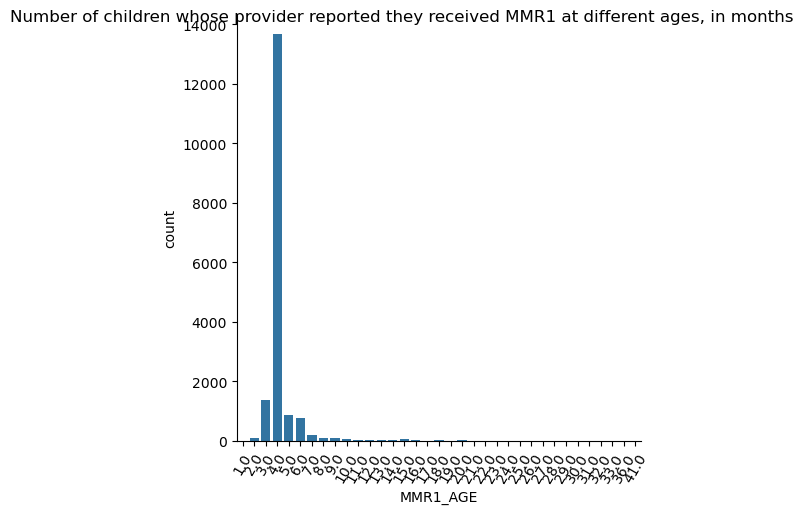

In [94]:
MMR1_AGE_count = sns.catplot(data=data, x="MMR1_AGE", kind = "count")
MMR1_AGE_count.fig.suptitle('Number of children whose provider reported they received MMR1 at different ages, in months')
for ax in MMR1_AGE_count.axes.flat:
    for label in ax.get_xticklabels():
        label.set_rotation(60)  # or 60 or 90 depending on your needs

# plt.tight_layout()
plt.show()

## 6.2.1 explore relationships between numeric and categorical variables 

Text(0.5, 0.98, 'Number of MMR shots received by 36 months of age, of a known type by year')

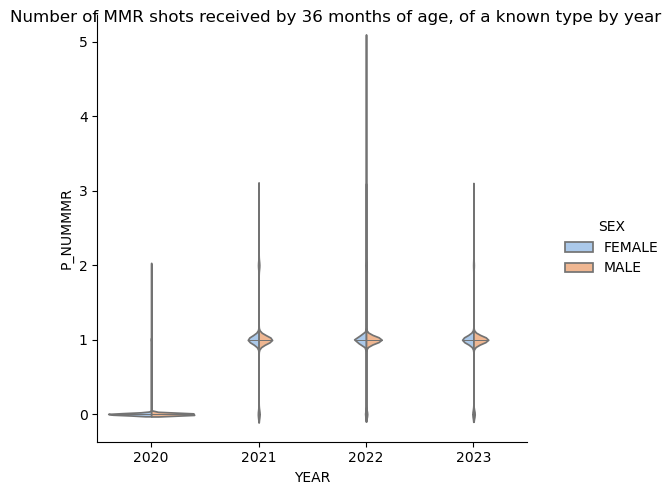

In [64]:
year_x_MMRshots_sex = sns.catplot(
    data=data, x="YEAR", y="P_NUMMMR", hue="SEX",
    kind="violin", inner="stick", split=True, palette="pastel",
)
year_x_MMRshots_sex.fig.suptitle("Number of MMR shots received by 36 months of age, of a known type by year")

Text(0.5, 0.98, 'Number of DT-containing shots received by 36 months of age,determined by provider info by year')

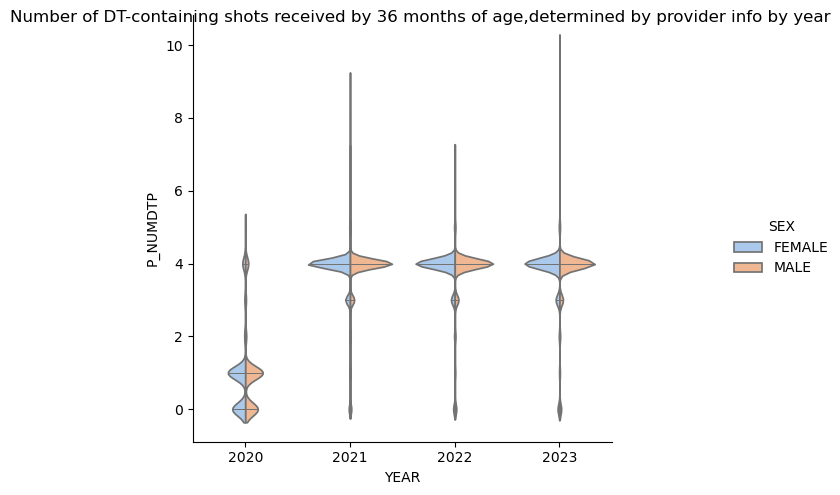

In [84]:
year_x_DTshots_sex = sns.catplot(
    data=data, x="YEAR", y="P_NUMDTP", hue="SEX",
    kind="violin", inner="stick", split=True, palette="pastel",
)
year_x_DTshots_sex.fig.suptitle("Number of DT-containing shots received by 36 months of age,determined by provider info by year")

# 6.3 Explore relationship between numeric variables

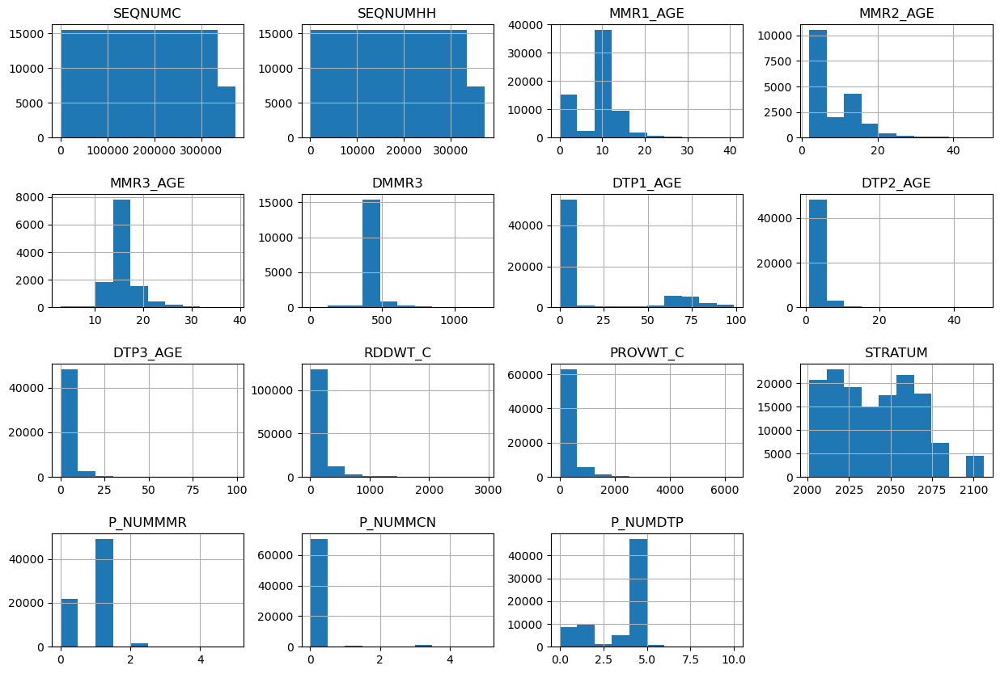

In [67]:
data.hist(figsize=(15,10))
plt.subplots_adjust(hspace=0.5);

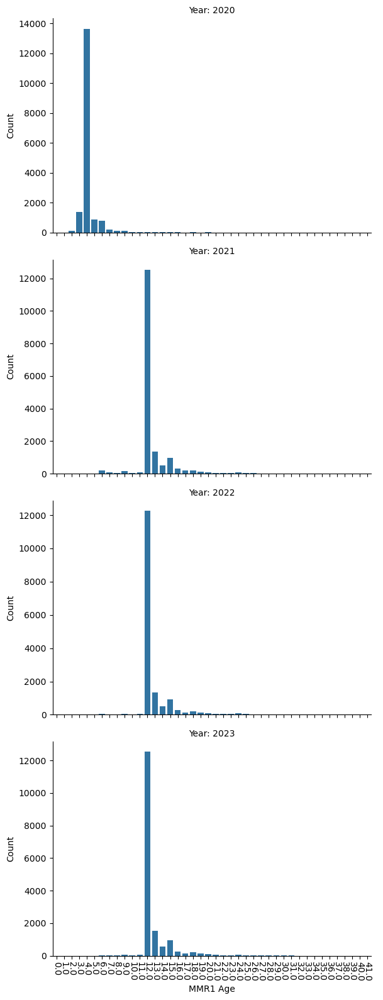

In [104]:
MMR1age_x_year = sns.catplot(
    data=data,
    x="MMR1_AGE",
    kind="count",
    col="YEAR",
    col_wrap=1,       # Adjust this based on the number of years
    height=4,
    aspect=1.5,
    sharey=False      # Allows each subplot to have its own y-axis scale
)
# Set axis labels and titles
MMR1age_x_year.set_axis_labels("MMR1 Age", "Count")
MMR1age_x_year.set_titles("Year: {col_name}")
for ax in MMR1age_x_year.axes.flat:
    for label in ax.get_xticklabels():
        label.set_rotation(-90) 
# Adjust layout
plt.tight_layout()
plt.show()

Text(0.5, 0.98, 'Age in months at which provider reported child received MMR1, by year')

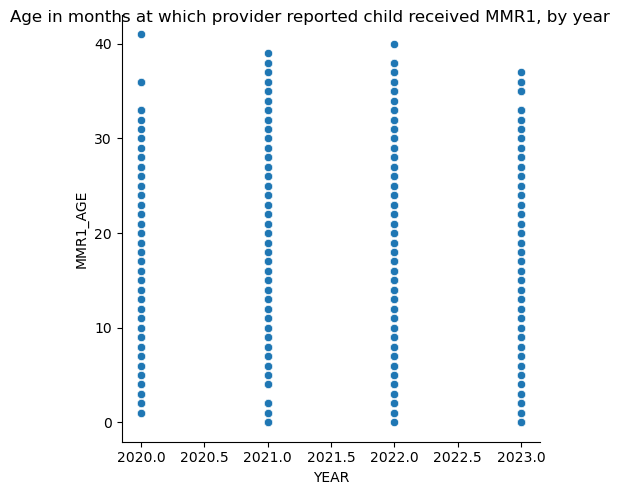

In [83]:
year_x_MMR1_AGE = sns.relplot(data=data, x="YEAR", y = "MMR1_AGE")
year_x_MMR1_AGE.fig.suptitle('Age in months at which provider reported child received MMR1, by year')

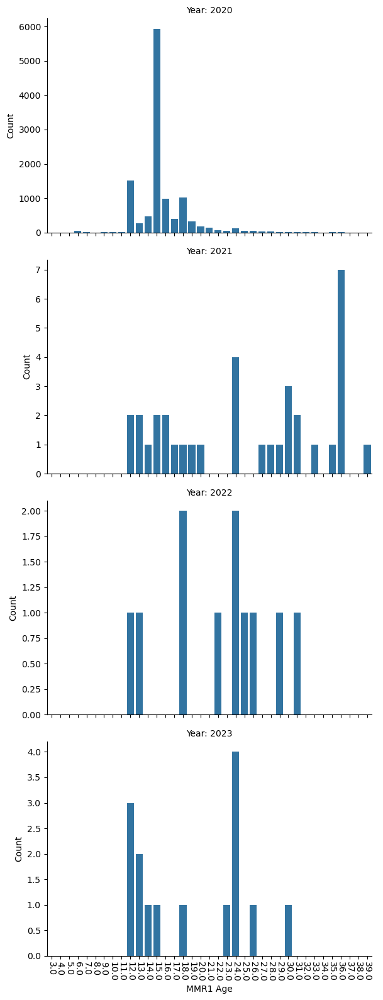

In [106]:
MMR3age_x_year = sns.catplot(data=data, x="MMR3_AGE", kind="count", col="YEAR", col_wrap=1, height=4, aspect=1.5,\
                             sharey=False)

# Set axis labels and titles
MMR3age_x_year.set_axis_labels("MMR1 Age", "Count")
MMR3age_x_year.set_titles("Year: {col_name}")
for ax in MMR3age_x_year.axes.flat:
    for label in ax.get_xticklabels():
        label.set_rotation(-90) 
# Adjust layout
plt.tight_layout()
plt.show()

# 6.4 Aggregate across variables to create a summary data set 

Dataframes that summarize categorical variables were already created in Section 6.1.4, they are combined with summaries of numerical data in this section

In [517]:
state_summary = data.groupby(['YEAR','STATE'], observed = True).agg(
    number_children_state=pd.NamedAgg(column='CHILDNM', aggfunc='size'), #could pick any column here
    P_NUMMMR_state=pd.NamedAgg(column='P_NUMMMR', aggfunc='mean'), 
    P_NUMMCN_state=pd.NamedAgg(column='P_NUMMCN', aggfunc='mean'),
    P_NUMDTP_state=pd.NamedAgg(column='P_NUMDTP', aggfunc='mean')
)
state_summary.head()

number_children_state  P_NUMMMR_state  P_NUMMCN_state  \
YEAR STATE                                                               
2020 ALABAMA                       510        0.003937        0.417323   
     ALASKA                        515        0.010526        0.210526   
     ARIZONA                       446        0.017094        0.461538   
     ARKANSAS                      780        0.000000        0.048426   
     CALIFORNIA                   1188        0.005425        0.386980   

                 P_NUMDTP_state  
YEAR STATE                       
2020 ALABAMA           0.988189  
     ALASKA            1.084211  
     ARIZONA           1.111111  
     ARKANSAS          0.721550  
     CALIFORNIA        1.164557

In [518]:
state_summary.index

MultiIndex([(2020,              'ALABAMA'),
            (2020,               'ALASKA'),
            (2020,              'ARIZONA'),
            (2020,             'ARKANSAS'),
            (2020,           'CALIFORNIA'),
            (2020,             'COLORADO'),
            (2020,          'CONNECTICUT'),
            (2020,             'DELAWARE'),
            (2020, 'DISTRICT OF COLUMBIA'),
            (2020,              'FLORIDA'),
            ...
            (2023,         'SOUTH DAKOTA'),
            (2023,            'TENNESSEE'),
            (2023,                'TEXAS'),
            (2023,                 'UTAH'),
            (2023,              'VERMONT'),
            (2023,             'VIRGINIA'),
            (2023,           'WASHINGTON'),
            (2023,        'WEST VIRGINIA'),
            (2023,            'WISCONSIN'),
            (2023,              'WYOMING')],
           names=['YEAR', 'STATE'], length=208)

In [519]:
outcome_summary_df.head()
outcome_summary_df.index

MultiIndex([(2020,              'ALABAMA'),
            (2020,               'ALASKA'),
            (2020,              'ARIZONA'),
            (2020,             'ARKANSAS'),
            (2020,           'CALIFORNIA'),
            (2020,             'COLORADO'),
            (2020,          'CONNECTICUT'),
            (2020,             'DELAWARE'),
            (2020, 'DISTRICT OF COLUMBIA'),
            (2020,              'FLORIDA'),
            ...
            (2023,         'SOUTH DAKOTA'),
            (2023,            'TENNESSEE'),
            (2023,                'TEXAS'),
            (2023,                 'UTAH'),
            (2023,              'VERMONT'),
            (2023,             'VIRGINIA'),
            (2023,           'WASHINGTON'),
            (2023,        'WEST VIRGINIA'),
            (2023,            'WISCONSIN'),
            (2023,              'WYOMING')],
           names=['YEAR', 'STATE'], length=208)

In [520]:
list_of_dfs = [state_summary, outcome_summary_df]
state_summary = pd.concat(list_of_dfs, axis=1)
state_summary.head()

number_children_state  P_NUMMMR_state  P_NUMMCN_state  \
YEAR STATE                                                               
2020 ALABAMA                       510        0.003937        0.417323   
     ALASKA                        515        0.010526        0.210526   
     ARIZONA                       446        0.017094        0.461538   
     ARKANSAS                      780        0.000000        0.048426   
     CALIFORNIA                   1188        0.005425        0.386980   

                 P_NUMDTP_state  PUT43133_UTD_prop  PU4313314_UTD_prop  \
YEAR STATE                                                               
2020 ALABAMA           0.988189           0.366667            0.382353   
     ALASKA            1.084211           0.351456            0.378641   
     ARIZONA           1.111111           0.358744            0.369955   
     ARKANSAS          0.721550           0.394872            0.410256   
     CALIFORNIA        1.164557           0.345118            0.352694   

                 PUT43133_UTD_prop  PUTD4313_UTD_prop  
YEAR STATE                                             
2020 ALABAMA              0.366667           0.388235  
     ALASKA               0.351456           0.386408  
     ARIZONA              0.358744           0.372197  
     ARKANSAS             0.394872           0.411538  
     CALIFORNIA           0.345118           0.358586

In [113]:
state_summary.sort_values(["YEAR","P_NUMMMR_state"], ascending = False)

,STATE,YEAR,number_children_state,P_NUMMMR_state,P_NUMMCN_state,P_NUMDTP_state
27,CONNECTICUT,2023,523,1.042802,0.011673,3.898833
143,OHIO,2023,934,1.022869,0.004158,3.725572
119,NEW HAMPSHIRE,2023,392,1.010309,0.000000,3.768041
87,MASSACHUSETTS,2023,534,0.996310,0.003690,3.907749
83,MARYLAND,2023,1124,0.994624,0.000000,3.849462
...,...,...,...,...,...,...
124,NEW MEXICO,2020,648,0.000000,0.220207,0.893782
96,MISSISSIPPI,2020,764,0.000000,0.089172,0.843949
60,IOWA,2020,440,0.000000,0.131579,0.929825
48,IDAHO,2020,630,0.000000,0.090659,0.914835
